In [87]:
import nltk
import string
import re
import numpy as np
import pandas as pd
import pickle

import matplotlib.pyplot as plt
import seaborn as sns
sns.set("white")

from nltk.corpus import stopwords
from nltk.stem.porter import *
from nltk.tokenize import word_tokenize,sent_tokenize
from sklearn.feature_extraction import _stop_words

from collections import Counter
from wordcloud import WordCloud
from sklearn.feature_extraction.text import TfidfVectorizer #sklearn算法包
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

import plotly.offline as py #plotly数据可视化,鼠标交互包
py.init_notebook_mode(connected=True)

import plotly.graph_objs as go
import plotly.tools as tls
%matplotlib inline

import bokeh.plotting as bp #bokeh数据可视化包
from bokeh.models import HoverTool,BoxSelectTool
from bokeh.models import ColumnDataSource
from bokeh.plotting import figure,output_notebook,show

import warnings
warnings.filterwarnings("ignore")
import logging
logging.getLogger("lda").setLevel(logging.WARNING)

ValueError: context must be in paper, notebook, talk, poster

In [23]:
train = pd.read_csv('/Users/eamonyin/Downloads/迪哥nlp/练习/train.tsv',sep='\t')
print(train.shape)

(1482535, 8)


In [24]:
train.dtypes

train_id               int64
name                  object
item_condition_id      int64
category_name         object
brand_name            object
price                float64
shipping               int64
item_description      object
dtype: object

In [19]:
train.head()

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description
0,0,MLB Cincinnati Reds T Shirt Size XL,3,Men/Tops/T-shirts,NaN,10.0,1,No description yet
1,1,Razer BlackWidow Chroma Keyboard,3,Electronics/Computers & Tablets/Components & P...,Razer,52.0,0,This keyboard is in great condition and works ...
2,2,AVA-VIV Blouse,1,Women/Tops & Blouses/Blouse,Target,10.0,1,Adorable top with a hint of lace and a key hol...
3,3,Leather Horse Statues,1,Home/Home Décor/Home Décor Accents,NaN,35.0,1,New with tags. Leather horses. Retail for [rm]...
4,4,24K GOLD plated rose,1,Women/Jewelry/Necklaces,NaN,44.0,0,Complete with certificate of authenticity


In [20]:
train.price.describe()

count    1.482535e+06
mean     2.673752e+01
std      3.858607e+01
min      0.000000e+00
25%      1.000000e+01
50%      1.700000e+01
75%      2.900000e+01
max      2.009000e+03
Name: price, dtype: float64

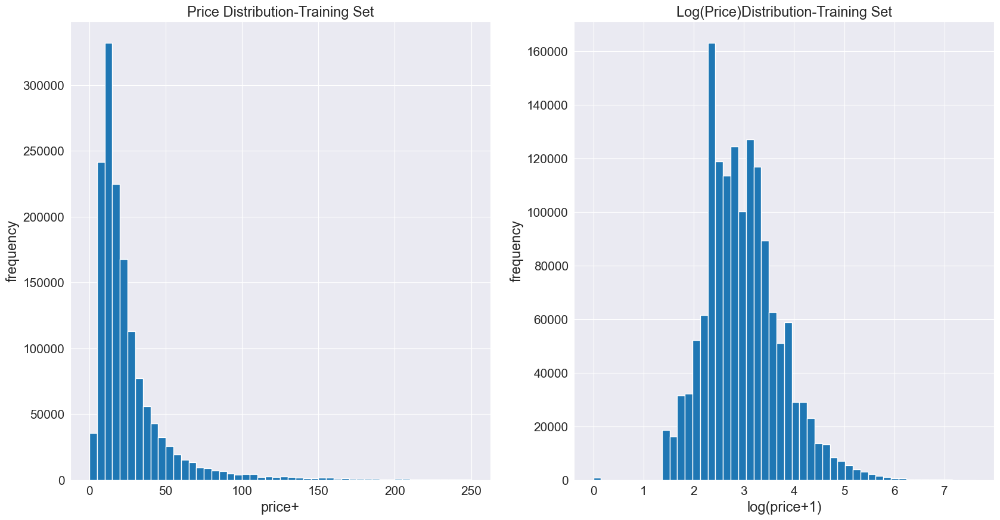

In [27]:
plt.subplot(1,2,1)#第一个图
(train['price']).plot.hist(bins=50,figsize=(20,10),edgecolor='white', range=[0, 250])
plt.xlabel('price+',fontsize=17)
plt.ylabel ('frequency',fontsize=17)
plt.tick_params (labelsize=15)
plt.title('Price Distribution-Training Set',fontsize=17)

plt.subplot (1, 2, 2)#第二个图,log变换
np.log (train['price']+1).plot.hist (bins=50, figsize=(20, 10), edgecolor='white')
plt.xlabel ('log(price+1)', fontsize=17)
plt.ylabel ('frequency', fontsize=17)
plt.tick_params (labelsize=15)
plt.title('Log(Price)Distribution-Training Set',fontsize=17)
plt.show ()

In [28]:
train.shipping.value_counts()/len(train)

shipping
0    0.552726
1    0.447274
Name: count, dtype: float64

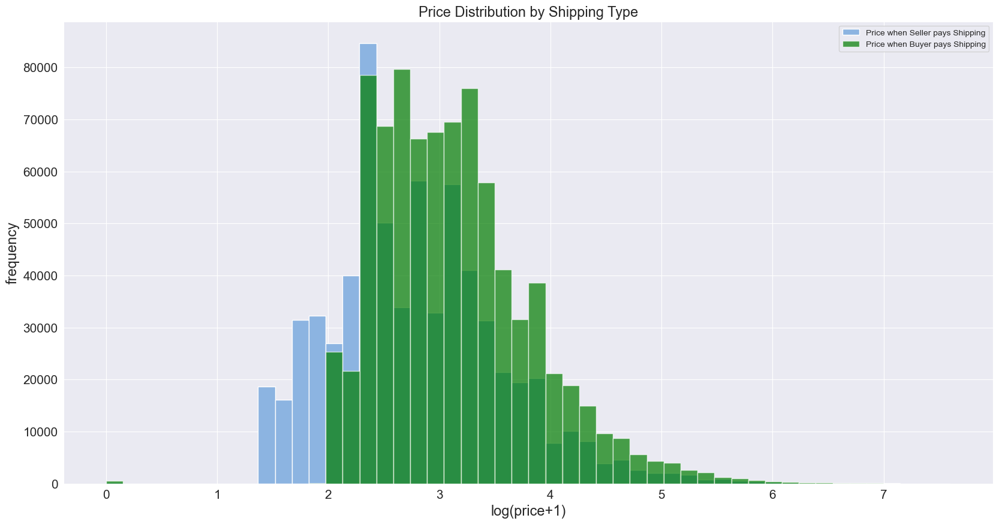

In [33]:
prc_shipBySeller = train.loc[train.shipping==1,'price'] #loc是pandas库中提取DataFrame中数据的
prc_shipByBuyer = train.loc[train.shipping==0,'price']

fig, ax = plt.subplots(figsize=(20,10))
ax.hist(np.log(prc_shipBySeller+1),color='#8CB4E1',alpha=1.0,bins=50,label='Price when Seller pays Shipping') #hist直方图，alpha透明度
ax.hist(np.log(prc_shipByBuyer+1),color='#007D00',alpha=0.7,bins=50,label='Price when Buyer pays Shipping')
ax.set (title='Histogram Comparison', ylabel='% of Dataset in Bin')
plt.legend ()
plt.xlabel ('log(price+1)', fontsize=17)
plt.ylabel ('frequency', fontsize=17)
plt.title('Price Distribution by Shipping Type', fontsize=17)
plt.tick_params (labelsize=15)
plt.show ()

In [35]:
print("There are %d unique calues in the category colume." % train['category_name'].nunique())

There are 1287 unique calues in the category colume.


In [48]:
train['category_name'].value_counts()[:5]

category_name
Women/Athletic Apparel/Pants, Tights, Leggings    60177
Women/Tops & Blouses/T-Shirts                     46380
Beauty/Makeup/Face                                34335
Beauty/Makeup/Lips                                29910
Electronics/Video Games & Consoles/Games          26557
Name: count, dtype: int64

In [58]:
def split_cat(text):
    try: return text.split('/')
    except: return("No Lable","No Lable","No Lable")

train['general_cat'] , train['subcat_1'] , train['subcat_2'] = zip(*train['category_name'].apply(lambda x: split_cat(x)))# apply将split_cat()函数应用到每一行，lambda创建匿名函数，*解包操作符，zip将结果打包成元祖 list1 = [1, 2, 3] 和 list2 = ['a', 'b', 'c'] 打包后 (1, 'a')、(2, 'b')、(3, 'c') 
train.head()

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description,general_cat,subcat_1,subcat_2
0,0,MLB Cincinnati Reds T Shirt Size XL,3,Men/Tops/T-shirts,NaN,10.0,1,No description yet,Men,Tops,T-shirts
1,1,Razer BlackWidow Chroma Keyboard,3,Electronics/Computers & Tablets/Components & P...,Razer,52.0,0,This keyboard is in great condition and works ...,Electronics,Computers & Tablets,Components & Parts
2,2,AVA-VIV Blouse,1,Women/Tops & Blouses/Blouse,Target,10.0,1,Adorable top with a hint of lace and a key hol...,Women,Tops & Blouses,Blouse
3,3,Leather Horse Statues,1,Home/Home Décor/Home Décor Accents,NaN,35.0,1,New with tags. Leather horses. Retail for [rm]...,Home,Home Décor,Home Décor Accents
4,4,24K GOLD plated rose,1,Women/Jewelry/Necklaces,NaN,44.0,0,Complete with certificate of authenticity,Women,Jewelry,Necklaces


In [63]:
x = train['general_cat'].value_counts().index.values.astype('str')
y = train['general_cat'].value_counts().values
percent = [("%.2f"%(percent*100))+"%" for percent in (y/len(train))]#计算类别数量占总体的百分比

import plotly.offline as py #plotly数据可视化,鼠标交互包
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls

tracel = go.Bar(x=x,y=y,text=percent,
                marker=dict(color=y,colorscale='Portland',
                            showscale=True,
                            reversescale = False))
layout = dict(title='Number of Items by Main Category', xaxis=dict(title='Category'), yaxis=dict(title='Count'))
fig=dict(data=[tracel], layout=layout)
py.iplot(fig)

In [ ]:
general_cats = train['general_cat'].unique()
x = [train.loc[train['general_cat'] ==cat,'price'] for cat in general_cats]
data = [go.Box(x=np.log(x[i]+1),name=general_cats[i])for i in range(len(general_cats))]
layout = dict(title='Price Distribution by General_cat Category', xaxis=dict(title='Frequency'),yaxis=dict(title='Category'))
fig = dict(data=data, layout=layout)
py.iplot(fig)

In [78]:
from nltk.corpus import stopwords
def wordCount(text):
    try:
        text = text.lower()
        regex = re.compile('[' +re.escape(string.punctuation) + '0-9\\r\\t\\n]')
        txt = regex.sub(" ",text)
        words = [w for w in txt.split(" ") if not w in stopwords.words('english') and len(w)>3]
        return len(words)
    except:
        return 0

In [79]:
train['desc_len'] = train['item_description'].apply(lambda x: wordCount(x))
train.head()

,train_id,name,item_condition_id,category_name,brand_name,price,shipping,item_description,general_cat,subcat_1,subcat_2,desc_len
0,0,MLB Cincinnati Reds T Shirt Size XL,3,Men/Tops/T-shirts,NaN,10.0,1,No description yet,Men,Tops,T-shirts,1
1,1,Razer BlackWidow Chroma Keyboard,3,Electronics/Computers & Tablets/Components & P...,Razer,52.0,0,This keyboard is in great condition and works ...,Electronics,Computers & Tablets,Components & Parts,14
2,2,AVA-VIV Blouse,1,Women/Tops & Blouses/Blouse,Target,10.0,1,Adorable top with a hint of lace and a key hol...,Women,Tops & Blouses,Blouse,10
3,3,Leather Horse Statues,1,Home/Home Décor/Home Décor Accents,NaN,35.0,1,New with tags. Leather horses. Retail for [rm]...,Home,Home Décor,Home Décor Accents,14
4,4,24K GOLD plated rose,1,Women/Jewelry/Necklaces,NaN,44.0,0,Complete with certificate of authenticity,Women,Jewelry,Necklaces,3


In [81]:
df = train.groupby('desc_len')['price'].mean().reset_index()
tracel = go.Scatter(
    x = df['desc_len'],
    y = np.log(df['price']+1),
    mode = 'lines+markers',
    name = 'lines+markers'
)
layout = dict(title='Average Log(Price by Description Length)',
              yaxis=dict(title='Average Log(Price)'),
              xaxis=dict(title='Description Length'))
fig = dict(data=[tracel], layout=layout)
py.iplot(fig)

In [84]:
from collections import Counter

# 过滤缺失值
train = train[pd.notnull(train['item_description'])]
# 不同种类的词典
tokenize = nltk.data.load('tokenizers/punkt/english.pickle')

car_desc = dict()
for cat in general_cats:
    text = "".join(train.loc[train['general_cat']==cat,'item_description'].values)
    car_desc[cat] = tokenize.tokenize(text)

flat_lst = [item for sublist in list(car_desc.values()) for item in sublist]
allWordsCount = Counter(flat_lst)
all_top10 = allWordsCount.most_common(20)
x = [w[0] for  w in all_top10]
y = [w[1] for  w in all_top10]

tracel = go.Bar(x=x , y=y , text= percent)    
layout = dict(title='Word Frequemcy',yaxis=dict(title='Count'),xaxis=dict(title='Word'))
fig = dict(data=[tracel], layout=layout)
py.iplot(fig)

In [111]:
from nltk.tokenize import word_tokenize,sent_tokenize
stop = set(stopwords.words('english'))
def tokenize(text):
    try:
        regex = re.compile('[' + re.escape(string.punctuation)+'0-9\\r\\t\\n]')
        text = regex.sub(" ",text)
        
        tokens_ = [word_tokenize(s) for s in sent_tokenize(text)]
        tokens = []
        for token_by_sent in tokens_:
            tokens += token_by_sent
        tokens = list (filter(lambda t: t.lower() not in stop, tokens))
        filtered_tokens = [w for w in tokens if re.search( '[a-zA-Z]' , w)]
        filtered_tokens = [w.lower() for w in filtered_tokens if len(w)>=3]
        
        return filtered_tokens
    except TypeError as e: print(text,e)

In [112]:
train['tokens'] = train['item_description'].map(tokenize)

In [113]:
train.reset_index(drop=True,inplace=True)

for description,tokens in zip(train['item_description'].head(),train['tokens'].head()):
    print('description:',description)
    print("tokens:",tokens)
    print()

description: No description yet
tokens: ['description', 'yet']

description: This keyboard is in great condition and works like it came out of the box. All of the ports are tested and work perfectly. The lights are customizable via the Razer Synapse app on your PC.
tokens: ['keyboard', 'great', 'condition', 'works', 'like', 'came', 'box', 'ports', 'tested', 'work', 'perfectly', 'lights', 'customizable', 'via', 'razer', 'synapse', 'app']

description: Adorable top with a hint of lace and a key hole in the back! The pale pink is a 1X, and I also have a 3X available in white!
tokens: ['adorable', 'top', 'hint', 'lace', 'key', 'hole', 'back', 'pale', 'pink', 'also', 'available', 'white']

description: New with tags. Leather horses. Retail for [rm] each. Stand about a foot high. They are being sold as a pair. Any questions please ask. Free shipping. Just got out of storage
tokens: ['new', 'tags', 'leather', 'horses', 'retail', 'stand', 'foot', 'high', 'sold', 'pair', 'questions', 'please', 

Text(0.5, 1.0, 'Electronic Top 100')

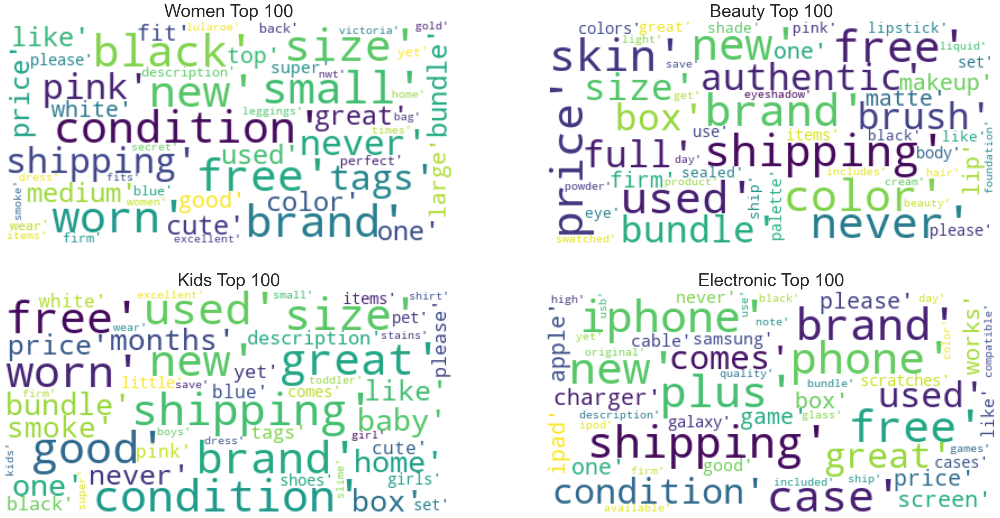

In [118]:
from wordcloud import WordCloud
cat_desc = dict ()
for cat in general_cats:
    text = " ".join(train.loc[train['general_cat']==cat, 'item_description']. values)
    cat_desc[cat] = tokenize (text)

women100 = Counter(cat_desc['Women']).most_common (100)
beauty100 = Counter(cat_desc['Beauty']).most_common (100)
kids100 = Counter(cat_desc ['Kids']). most_common (100)
electronics100 = Counter(cat_desc ['Electronics']). most_common (100)

def generate_wordcloud (tup) :
    wordcloud = WordCloud(background_color='white',max_words=50, max_font_size=40, random_state=42). generate (str (tup))
    return wordcloud

fig, axes = plt. subplots(2, 2, figsize=(30, 15))
ax = axes [0, 0]
ax. imshow (generate_wordcloud (women100), interpolation="bilinear")
ax. axis('off')
ax. set_title("Women Top 100", fontsize=30)
ax = axes [0, 1]
ax. imshow (generate_wordcloud (beauty100))
ax. axis ('off')
ax. set_title ("Beauty Top 100", fontsize=30)
ax = axes [1, 0]
ax. imshow (generate_wordcloud (kids100))
ax. axis('off')
ax. set_title("Kids Top 100", fontsize=30)
ax = axes [1, 1]
ax. imshow (generate_wordcloud (electronics100))
ax. axis ('off')
ax. set_title("Electronic Top 100", fontsize=30)

In [120]:
from sklearn.feature_extraction.text import TfidfVectorizer
vectorizer = TfidfVectorizer(min_df=10, 
                             max_features=180000, #生成矩阵大小
                             tokenizer = tokenize,
                             ngram_range=(1,2)) #1-2个词为一组

all_desc = train['item_description'].values
vz = vectorizer.fit_transform(list(all_desc))

vz.shape

/opt/miniconda3/envs/deepshare/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:517: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'



(1482529, 180000)

In [122]:
tfidf = dict(zip(vectorizer.get_feature_names_out(),vectorizer.idf_))
tfidf = pd.DataFrame(columns=['tfidf']).from_dict(dict(tfidf),orient='index')
tfidf.columns = ['tfidf']
tfidf.sort_values(by=['tfidf'],ascending=True).head(10)

,tfidf
new,2.175560
size,2.330305
brand,2.755321
condition,2.799921
brand new,2.874311
free,2.905830
shipping,3.072034
worn,3.104767
used,3.163069
never,3.275988


In [123]:
trn = train.copy()
trn['is_train'] = 1

sample_size = 15000

combiend_df = pd.concat([trn])
combiend_sample = combiend_df.sample(n=sample_size)
vz_sample = vectorizer.fit_transform(list(combiend_sample['item_description']))

/opt/miniconda3/envs/deepshare/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:517: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'



In [129]:
#矩阵分解
from sklearn.decomposition import TruncatedSVD
#降到30维
n_comp = 30
svd = TruncatedSVD(n_components=n_comp, random_state=42)
svd_tfidf = svd.fit_transform(vz_sample)

In [130]:
from sklearn.manifold import TSNE
tsne_model = TSNE(n_components=2,verbose=1,random_state=42,n_iter=500)

In [131]:
tsne_tfidf = tsne_model.fit_transform(svd_tfidf)

/opt/miniconda3/envs/deepshare/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 15000 samples in 0.001s...
[t-SNE] Computed neighbors for 15000 samples in 0.391s...
[t-SNE] Computed conditional probabilities for sample 1000 / 15000
[t-SNE] Computed conditional probabilities for sample 2000 / 15000
[t-SNE] Computed conditional probabilities for sample 3000 / 15000
[t-SNE] Computed conditional probabilities for sample 4000 / 15000
[t-SNE] Computed conditional probabilities for sample 5000 / 15000
[t-SNE] Computed conditional probabilities for sample 6000 / 15000
[t-SNE] Computed conditional probabilities for sample 7000 / 15000
[t-SNE] Computed conditional probabilities for sample 8000 / 15000
[t-SNE] Computed conditional probabilities for sample 9000 / 15000
[t-SNE] Computed conditional probabilities for sample 10000 / 15000
[t-SNE] Computed conditional probabilities for sample 11000 / 15000
[t-SNE] Computed conditional probabilities for sample 12000 / 15000
[t-SNE] Computed conditional probabilities for sam

In [136]:
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
# 初始化Bokeh在Jupyter Notebook中的输出模式
output_notebook()
plot_tfidf = figure(width=700, height=600,
                        title="tf-idf clustering of the item description",
                        tools="pan, wheel_zoom, box_zoom, reset, hover",
                        x_axis_type=None, y_axis_type=None, min_border=1)

Loading BokehJS ...

In [139]:
from bokeh.models import HoverTool
combiend_sample.reset_index(inplace=True, drop=True)
tfidf_df = pd.DataFrame (tsne_tfidf, columns=['x', 'y'])
tfidf_df['description'] = combiend_sample['item_description']
tfidf_df['tokens'] = combiend_sample['tokens']
tfidf_df['category'] = combiend_sample['general_cat' ]

plot_tfidf. scatter(x='x', y='y', source=tfidf_df, alpha=0.7)
hover = plot_tfidf.select(dict(type=HoverTool))
hover.tooltips={"description": "@description","tokens": "@tokens", "category": "@category"}
show (plot_tfidf)

In [142]:
from sklearn.cluster import MiniBatchKMeans
num_clusters = 10
kmeans_model = MiniBatchKMeans (n_clusters=num_clusters,init='k-means++',n_init=1,init_size=1000, batch_size=1000, verbose=0, max_iter=1000)
                              
kmeans = kmeans_model.fit (vz)
kmeans_clusters = kmeans.predict (vz)
kmeans_distances = kmeans. transform(vz)

sorted_centroids = kmeans.cluster_centers_.argsort()[:, ::-1]
terms = vectorizer.get_feature_names_out()

kmeans = kmeans_model.fit (vz_sample)
kmeans_clusters = kmeans.predict (vz_sample)
kmeans_distances = kmeans.transform (vz_sample)

tsne_kmeans = tsne_model.fit_transform(kmeans_distances)

/opt/miniconda3/envs/deepshare/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 15000 samples in 0.006s...
[t-SNE] Computed neighbors for 15000 samples in 0.841s...
[t-SNE] Computed conditional probabilities for sample 1000 / 15000
[t-SNE] Computed conditional probabilities for sample 2000 / 15000
[t-SNE] Computed conditional probabilities for sample 3000 / 15000
[t-SNE] Computed conditional probabilities for sample 4000 / 15000
[t-SNE] Computed conditional probabilities for sample 5000 / 15000
[t-SNE] Computed conditional probabilities for sample 6000 / 15000
[t-SNE] Computed conditional probabilities for sample 7000 / 15000
[t-SNE] Computed conditional probabilities for sample 8000 / 15000
[t-SNE] Computed conditional probabilities for sample 9000 / 15000
[t-SNE] Computed conditional probabilities for sample 10000 / 15000
[t-SNE] Computed conditional probabilities for sample 11000 / 15000
[t-SNE] Computed conditional probabilities for sample 12000 / 15000
[t-SNE] Computed conditional probabilities for sam

In [158]:
import pandas as pd
import bokeh.plotting as bp #bokeh数据可视化包
kmeans_df = pd.DataFrame (tsne_kmeans,columns=['x', 'y'])
kmeans_df ['cluster'] = kmeans_clusters
kmeans_df['description' ] = combiend_sample['item_description' ]
kmeans_df['category'] = combiend_sample['general_cat']
plot_kmeans = bp. figure(outer_width=700, outer_height=600,title="KMeans clustering of the description",tools="pan, wheel_zoom, box_zoom,hover",x_axis_type=None, y_axis_type=None, min_border=1)
kmeans_clusters

array([2, 8, 5, ..., 3, 2, 8], dtype=int32)

In [161]:
colormap = {'0':'red','1':'green','2':'blue','3':'black','4':'yellow','5':'pink','6':'purple','7':'grey','8':'brown','9':'orange'}

def get_color(num) :
    if num == 0:
        return 'red'
    if num == 1:
        return 'green'
    if num == 2:
        return 'blue'
    if num == 3:
        return 'black'
    if num == 4:
        return 'yellow'
    if num == 5:
        return 'pink'
    if num == 6:
        return 'purple'
    if num == 7:
        return 'grey'
    if num == 8:
        return 'brown'
    if num == 9:
        return 'orange'
color = pd.Series(kmeans_clusters).apply(get_color)    

In [163]:
from bokeh.models import ColumnDataSource

colormap = {'0': 'red', '1': 'green', '2': 'blue', '3': 'black', '4': 'yellow'}
source = ColumnDataSource (data=dict(x=kmeans_df['x'], y=kmeans_df['y'],color=color,description=kmeans_df['description'], category=kmeans_df['category' ], cluster=kmeans_df['cluster' ]))   
plot_kmeans.scatter (x='x', y= 'y', color= 'color', source=source)
hover = plot_kmeans.select (dict (type=HoverTool) )
hover. tooltips={"description": "@description","category": "@category", "cluster":"@cluster"}
show (plot_kmeans)

In [168]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

vectorizer = CountVectorizer (min_df=4,max_features=180000, tokenizer=tokenize, ngram_range= (1, 2))
cvz = vectorizer. fit_transform(combiend_sample['item_description' ])
lda_model = LatentDirichletAllocation(n_components=10,learning_method='online', max_iter=20, random_state=42)
X_topics = lda_model.fit_transform(cvz)

n_top_words = 10
topic_summaries = []
topic_word = lda_model.components_ # get the topic words
vocab = vectorizer.get_feature_names_out()
for i,topic_dist in enumerate(topic_word):
    topic_words = np.array(vocab)[np.argsort(topic_dist)][:-(n_top_words+1):-1]
    topic_summaries.append(' '. join(topic_words))
    print('Topic{}:{}'.format(i,' |'.join(topic_words)))

/opt/miniconda3/envs/deepshare/lib/python3.9/site-packages/sklearn/feature_extraction/text.py:517: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'



Topic0:pink |set |secret |victoria |victoria secret |color |matte |lace |retails |secret pink
Topic1:never |description |yet |description yet |worn |never worn |never used |used |new never |bought
Topic2:size |black |small |tags |new |worn |medium |white |cute |top
Topic3:skin |full |sealed |brush |use |cream |hair |eye |used |new
Topic4:free |shipping |free shipping |bundle |price |home |items |ship |smoke |firm
Topic5:please |one |see |make |great |need |thanks |looking |look |also
Topic6:new |brand |brand new |box |price |authentic |bag |comes |original |includes
Topic7:dress |material |twice |size |stretchy |high |cup |dunn |rae |rae dunn
Topic8:condition |good |great |used |good condition |great condition |times |worn |size |still
Topic9:iphone |case |green |plus |phone |blue |apple |iphone plus |disney |bottle


In [169]:
tsne_lda = tsne_model.fit_transform(X_topics)

/opt/miniconda3/envs/deepshare/lib/python3.9/site-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.



[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 15000 samples in 0.003s...
[t-SNE] Computed neighbors for 15000 samples in 0.798s...
[t-SNE] Computed conditional probabilities for sample 1000 / 15000
[t-SNE] Computed conditional probabilities for sample 2000 / 15000
[t-SNE] Computed conditional probabilities for sample 3000 / 15000
[t-SNE] Computed conditional probabilities for sample 4000 / 15000
[t-SNE] Computed conditional probabilities for sample 5000 / 15000
[t-SNE] Computed conditional probabilities for sample 6000 / 15000
[t-SNE] Computed conditional probabilities for sample 7000 / 15000
[t-SNE] Computed conditional probabilities for sample 8000 / 15000
[t-SNE] Computed conditional probabilities for sample 9000 / 15000
[t-SNE] Computed conditional probabilities for sample 10000 / 15000
[t-SNE] Computed conditional probabilities for sample 11000 / 15000
[t-SNE] Computed conditional probabilities for sample 12000 / 15000
[t-SNE] Computed conditional probabilities for sam

In [173]:
import pandas as pd
import bokeh.plotting as bp #bokeh数据可视化包
unnormalized = np.matrix (X_topics)
doc_topic = unnormalized/unnormalized.sum(axis=1)
lda_keys = []
for i, tweet in enumerate (combiend_sample['item_description']):
    lda_keys += [doc_topic[i].argmax()]
lda_df = pd. DataFrame (tsne_lda, columns=['x','y'])
lda_df['description' ] = combiend_sample['item_description' ]
lda_df ['category'] = combiend_sample['general_cat' ]
lda_df ['topic'] = lda_keys
lda_df ['topic'] = lda_df['topic'].map(int)
plot_lda = bp.figure(outer_width=700, outer_height=600,title="KMeans clustering of the description",tools="pan, wheel_zoom, box_zoom,hover",x_axis_type=None, y_axis_type=None, min_border=1)

colormap = {'0':'red','1':'green','2':'blue','3':'black','4':'yellow','5':'pink','6':'purple','7':'grey','8':'brown','9':'orange'}

def get_color(num) :
    if num == 0:
        return 'red'
    if num == 1:
        return 'green'
    if num == 2:
        return 'blue'
    if num == 3:
        return 'black'
    if num == 4:
        return 'yellow'
    if num == 5:
        return 'pink'
    if num == 6:
        return 'purple'
    if num == 7:
        return 'grey'
    if num == 8:
        return 'brown'
    if num == 9:
        return 'orange'
color = pd.Series(kmeans_clusters).apply(get_color)    

source = ColumnDataSource (data=dict(x=kmeans_df['x'], y=kmeans_df['y'],color=color,description=kmeans_df['description'], category=kmeans_df['category' ], cluster=kmeans_df['cluster']))   
plot_lda.scatter (x='x', y= 'y', color= 'color', source=source)
hover = plot_lda.select (dict (type=HoverTool) )
hover. tooltips={"description": "@description","category": "@category", "topic":"@topic"}
show (plot_lda)